In [1]:
%cd ..

from bokeh.io import output_notebook, reset_output, show, save
from Analysis.utilities import *

try:
    reset_output()
    output_notebook()
except:
    output_notebook()


/home/dtic/Github/dualization_dataset


Holoviews not installed, will not be able to generate violin plots


Loading BokehJS ...

-----
# VELOCITY DISTRIBUTION

---

The 24 samples tested across all participants can be found in

```shell
/midi_files/Repetitions/tested_with_four_participants/[test_id]/*.mid
```

---

The rest of 48 samples (only tested with Participant_1) can be found in

```shell
/midi_files/Repetitions/tested_with_Participant_1_Only/[test_id]/*.mid
```

----

**NOTE** `test_id` corresponds to the sample tags in [GrooveMidiDataset]()

```shell
test_id = f"{session}_{style}_{tempo}_{type=Beat}_{meter=4-4}_{SegmentFromPerformace}}"
```
----

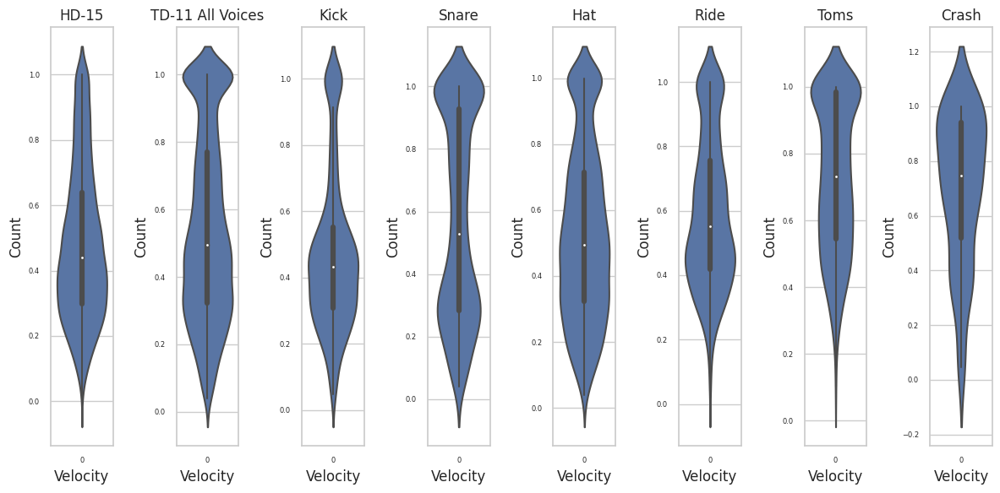

In [2]:
vels = {
    "HD-15": get_velocities_from_repetition_midis(root_path= "./midi_files/"),
    "TD-11 All Voices": get_velocities_from_original_midis(root_path= "./midi_files/"),
    "Kick": get_velocities_from_original_midis(root_path= "./midi_files/", voice_idx=0),
    "Snare": get_velocities_from_original_midis(root_path= "./midi_files/", voice_idx=1),
    "Hat": get_velocities_from_original_midis(root_path= "./midi_files/", voice_idx=[2, 3]),
    "Ride": get_velocities_from_original_midis(root_path= "./midi_files/", voice_idx=4),
    "Toms": get_velocities_from_original_midis(root_path= "./midi_files/", voice_idx=5),
    "Crash": get_velocities_from_original_midis(root_path= "./midi_files/", voice_idx=6),
}
fig, axes = violinplot_grid(vels, ncols=8, figsize=(12, 6), fontsize=6)

vels_normalized_by_mean_var  = {
    k: (v - np.mean(v)) / np.std(v) for k, v in vels.items()
}
fig, axes = violinplot_grid(vels_normalized_by_mean_var, ncols=8, figsize=(12, 6), fontsize=6)

# match the dimensions of the violin plots
for ax in axes:
    ax.set_ylim(-3, 3)


array([0.00787402, 0.08661417, 0.11023622, 0.12598425, 0.14173228,
       0.15748031, 0.17322835, 0.18110236, 0.18897638, 0.19685039,
       0.20472441, 0.21259843, 0.22834646, 0.22834646, 0.23622047,
       0.24409449, 0.24409449, 0.2519685 , 0.25984252, 0.26771654,
       0.27559055, 0.28346457, 0.28346457, 0.29133858, 0.2992126 ,
       0.2992126 , 0.30708661, 0.30708661, 0.31496063, 0.32283465,
       0.33070866, 0.33070866, 0.34645669, 0.34645669, 0.35433071,
       0.36220472, 0.36220472, 0.36220472, 0.37007874, 0.37795276,
       0.38582677, 0.38968504, 0.39370079, 0.4015748 , 0.40944882,
       0.41732283, 0.41732283, 0.41732283, 0.42519685, 0.43307087,
       0.44094488, 0.4488189 , 0.45669291, 0.46456693, 0.47244094,
       0.48031496, 0.48031496, 0.48818898, 0.49606299, 0.50393701,
       0.51181102, 0.51968504, 0.52755906, 0.53543307, 0.53543307,
       0.54330709, 0.5511811 , 0.55905512, 0.56692913, 0.58267717,
       0.59055118, 0.5984252 , 0.60629921, 0.61417323, 0.62992

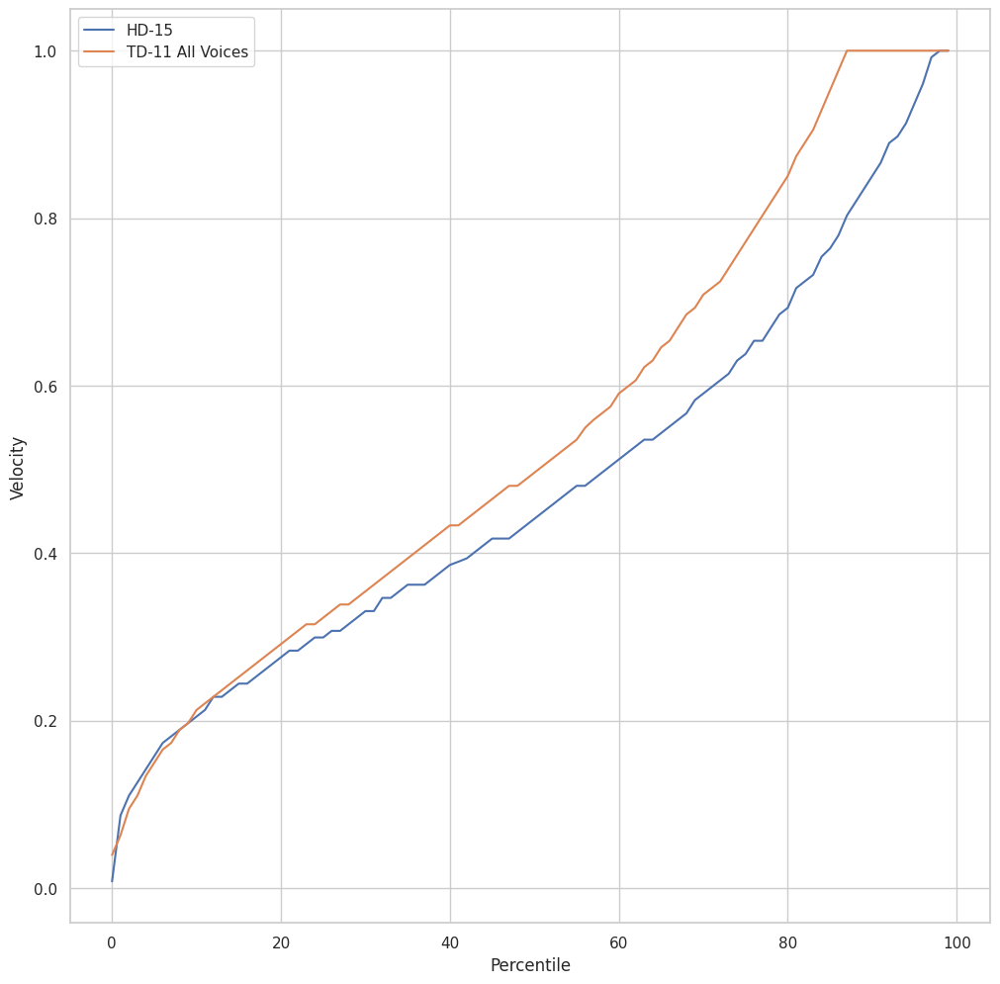

In [3]:

hd15 = np.percentile(vels["HD-15"], np.arange(100))
td11 = np.percentile(vels["TD-11 All Voices"], np.arange(100))

percentileDict = {
    "HD-15": hd15,
    "TD-11 All Voices": td11,
}


def plot_percentileDict(dict_):
    x_axis = np.arange(100)
    fig, ax = plt.subplots(figsize=(12, 12))
    for k, v in dict_.items():
        ax.plot(x_axis, v, label=k)
    ax.legend()
    ax.set_xlabel("Percentile")
    ax.set_ylabel("Velocity")
    return fig, ax

plot_percentileDict(percentileDict)
hd15

In [4]:
def map_hd15_to_td11(x):
    td11_100_percentiles = np.array([
       0.03937008, 0.06299213, 0.09448819, 0.11023622, 0.13385827,
       0.1496063 , 0.16535433, 0.17322835, 0.18897638, 0.19685039,
       0.21259843, 0.22047244, 0.22834646, 0.23622047, 0.24409449,
       0.2519685 , 0.25984252, 0.26771654, 0.27559055, 0.28346457,
       0.29133858, 0.2992126 , 0.30708661, 0.31496063, 0.31496063,
       0.32283465, 0.33070866, 0.33858268, 0.33858268, 0.34645669,
       0.35433071, 0.36220472, 0.37007874, 0.37795276, 0.38582677,
       0.39370079, 0.4015748 , 0.40944882, 0.41732283, 0.42519685,
       0.43307087, 0.43307087, 0.44094488, 0.4488189 , 0.45669291,
       0.46456693, 0.47244094, 0.48031496, 0.48031496, 0.48818898,
       0.49606299, 0.50393701, 0.51181102, 0.51968504, 0.52755906,
       0.53543307, 0.5496063 , 0.55905512, 0.56692913, 0.57480315,
       0.59055118, 0.5984252 , 0.60629921, 0.62204724, 0.62992126,
       0.64566929, 0.65354331, 0.66929134, 0.68503937, 0.69291339,
       0.70866142, 0.71653543, 0.72440945, 0.74015748, 0.75590551,
       0.77165354, 0.78740157, 0.80314961, 0.81889764, 0.83464567,
       0.8503937 , 0.87401575, 0.88976378, 0.90551181, 0.92913386,
       0.95275591, 0.97637795, 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ])

    hd15_100_percentiles = np.array([
       0.00787402, 0.08661417, 0.11023622, 0.12598425, 0.14173228,
       0.15748031, 0.17322835, 0.18110236, 0.18897638, 0.19685039,
       0.20472441, 0.21259843, 0.22834646, 0.22834646, 0.23622047,
       0.24409449, 0.24409449, 0.2519685 , 0.25984252, 0.26771654,
       0.27559055, 0.28346457, 0.28346457, 0.29133858, 0.2992126 ,
       0.2992126 , 0.30708661, 0.30708661, 0.31496063, 0.32283465,
       0.33070866, 0.33070866, 0.34645669, 0.34645669, 0.35433071,
       0.36220472, 0.36220472, 0.36220472, 0.37007874, 0.37795276,
       0.38582677, 0.38968504, 0.39370079, 0.4015748 , 0.40944882,
       0.41732283, 0.41732283, 0.41732283, 0.42519685, 0.43307087,
       0.44094488, 0.4488189 , 0.45669291, 0.46456693, 0.47244094,
       0.48031496, 0.48031496, 0.48818898, 0.49606299, 0.50393701,
       0.51181102, 0.51968504, 0.52755906, 0.53543307, 0.53543307,
       0.54330709, 0.5511811 , 0.55905512, 0.56692913, 0.58267717,
       0.59055118, 0.5984252 , 0.60629921, 0.61417323, 0.62992126,
       0.63779528, 0.65354331, 0.65354331, 0.66929134, 0.68503937,
       0.69291339, 0.71653543, 0.72440945, 0.73228346, 0.75401575,
       0.76377953, 0.77952756, 0.80314961, 0.81889764, 0.83464567,
       0.8503937 , 0.86614173, 0.88976378, 0.8976378 , 0.91338583,
       0.93700787, 0.96062992, 0.99212598, 1.        , 1.        ])

    # find the closest value in source_100_percentiles
    # and return the corresponding value in target_100_percentiles
    idx = np.argmin(np.abs(hd15_100_percentiles - x))
    return td11_100_percentiles[idx]


def get_original_drum_heatmaps(root_path, divs_per_16_note_grid=12,
                          separate_by_participant_ids=None, redo_y_labels=False,
                          resize_witdth_ratio=1, resize_height_ratio=1, mapper_fn=None):
    if separate_by_participant_ids is None:
        list_of_filter_dicts_for_subsets = None
    else:
        list_of_filter_dicts_for_subsets = [
            {"performer": [participant_id]} for participant_id in separate_by_participant_ids]

    hvo_sequences = get_original_files_as_hvo_seqs(root_path, mapper_fn=mapper_fn)

    evaluator_test_set = Evaluator(
        hvo_sequences,
        list_of_filter_dicts_for_subsets=list_of_filter_dicts_for_subsets,
        _identifier="reps_tested_with_four_participants",
        n_samples_to_use=-1,
        max_hvo_shape=(32, 21),
        need_hit_scores=False,
        need_velocity_distributions=False,
        need_offset_distributions=False,
        need_rhythmic_distances=False,
        need_heatmap=True,
        need_global_features=False,
        need_audio=False,
        need_piano_roll=False,
        n_samples_to_synthesize_and_draw=5,  # "all",
        disable_tqdm=False
    )

    # create dummy predictions
    evaluator_test_set.predictions = evaluator_test_set.get_ground_truth_hvos_array()
    final_tabs = evaluator_test_set.get_velocity_heatmaps(bins=[32 * divs_per_16_note_grid, 64])

    if redo_y_labels:
        for tab in final_tabs.tabs:
            # change y axis tick labels
            if separate_by_participant_ids is None:
                tab._property_values['child'].yaxis[0].major_label_overrides = {loc: f"All Participants" for loc in
                                                           tab._property_values['child'].yaxis[0].major_label_overrides.keys()}
            else:
                tab._property_values['child'].yaxis[0].major_label_overrides = {loc: f"Participant {x}" for x, loc in
                                                           zip(separate_by_participant_ids, tab._property_values['child'].yaxis[0].major_label_overrides.keys())}

    if resize_witdth_ratio != 1 or resize_height_ratio != 1:
        for tab in final_tabs.tabs:
            tab._property_values['child'].width = int(tab._property_values['child'].width * resize_witdth_ratio)
            tab._property_values['child'].height = int(tab._property_values['child'].height * resize_height_ratio)

    return final_tabs


In [5]:
fig_four_ptcpnts_rps_fig = getRepetitionHeatmaps(
    root_path= "./midi_files/Repetitions/tested_with_four_participants/",
    separate_by_participant_ids=[1, 2, 3, 4],
    redo_y_labels=True,
    divs_per_16_note_grid=12,
    resize_witdth_ratio=0.7,
    resize_height_ratio=1.02)
show(fig_four_ptcpnts_rps_fig)

In [6]:
del(fig_four_ptcpnts_rps_fig.tabs[0]._property_values['child'].renderers[-5:])

In [7]:
del(fig_four_ptcpnts_rps_fig.tabs[0]._property_values['child'].renderers[::2])

In [8]:
fig_four_ptcpnts_rps_fig.tabs[0]._property_values['child'].renderers[0]._property_values['glyph'].__dict__

{'_id': '2138',
 '_event_callbacks': {},
 '_callbacks': {},
 '_document': <bokeh.document.document.Document at 0x7f3ef4144fd0>,
 '_temp_document': None,
 '_property_values': {'image': 'image',
  'x': 0.0,
  'y': 1.0,
  'dw': 31.457,
  'dh': 126.0,
  'color_mapper': LinearColorMapper(id='2139', ...)},
 '_unstable_default_values': {'tags': [],
  'js_event_callbacks': {},
  'js_property_callbacks': {}},
 '_unstable_themed_values': {},
 '_initialized': True}

In [9]:
show(fig_four_ptcpnts_rps_fig)


In [10]:
fig_four_ptcpnts_rps_fig.tabs[0]._property_values['child'].renderers

[GlyphRenderer(id='2147', ...),
 GlyphRenderer(id='2166', ...),
 GlyphRenderer(id='2185', ...),
 GlyphRenderer(id='2204', ...)]